In [1]:
#This will contain all of our library imports
from sqlalchemy import create_engine
import pymysql
import ydata_profiling
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np

In [2]:
#needed to aquire the data from a service
connection = pymysql.connect(host='data-analytics-2018.cbrosir2cswx.us-east-1.rds.amazonaws.com',
user='deepAnalytics',
password='Sqltask1234!',
database='Credit',
charset='utf8mb4',
cursorclass=pymysql.cursors.DictCursor)

In [3]:
#put the data into a variable
df = pd.read_sql('SELECT * FROM credit', con=connection)


C:\Users\hardi\AppData\Local\Temp\ipykernel_26052\1256623849.py:2: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql('SELECT * FROM credit', con=connection)


In [4]:
#taking a glance at the data
df.head(2402)


,X1,X2,X3,X4,X5,X6,X7,X8,X9,X10,...,X15,X16,X17,X18,X19,X20,X21,X22,X23,Y
0,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
1,20000,female,university,1,24,2,2,-1,-1,-2,...,0,0,0,0,689,0,0,0,0,default
2,120000,female,university,2,26,-1,2,0,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,default
3,90000,female,university,2,34,0,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,not default
4,50000,female,university,1,37,0,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,not default
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2397,200000,male,university,1,29,0,0,0,2,2,...,48367,49366,47539,2078,3900,1900,1904,12,5224,not default
2398,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
2399,20000,female,university,1,24,2,2,-1,-1,-2,...,0,0,0,0,689,0,0,0,0,default
2400,120000,female,university,2,26,-1,2,0,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,default


In [5]:
#Saving it as csv file tot be used later
df.to_csv("credit.csv", index= False)

In [6]:
#making it to we have the right header for the data
credit = pd.read_csv("credit.csv", header = 1)

In [7]:
#taking a glance at the data after we did that
credit.head(2402)

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,20000,female,university,1,24,2,2,-1,-1,-2,...,0,0,0,0,689,0,0,0,0,default
1,120000,female,university,2,26,-1,2,0,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,default
2,90000,female,university,2,34,0,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,not default
3,50000,female,university,1,37,0,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,not default
4,50000,male,university,1,57,-1,0,-1,0,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,not default
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2397,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
2398,20000,female,university,1,24,2,2,-1,-1,-2,...,0,0,0,0,689,0,0,0,0,default
2399,120000,female,university,2,26,-1,2,0,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,default
2400,90000,female,university,2,34,0,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,not default


In [8]:
credit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3669 entries, 0 to 3668
Data columns (total 24 columns):
 #   Column                      Non-Null Count  Dtype 
---  ------                      --------------  ----- 
 0   LIMIT_BAL                   3669 non-null   object
 1   SEX                         3669 non-null   object
 2   EDUCATION                   3669 non-null   object
 3   MARRIAGE                    3669 non-null   object
 4   AGE                         3669 non-null   object
 5   PAY_0                       3669 non-null   object
 6   PAY_2                       3669 non-null   object
 7   PAY_3                       3669 non-null   object
 8   PAY_4                       3669 non-null   object
 9   PAY_5                       3669 non-null   object
 10  PAY_6                       3669 non-null   object
 11  BILL_AMT1                   3669 non-null   object
 12  BILL_AMT2                   3669 non-null   object
 13  BILL_AMT3                   3669 non-null   obje

In [9]:
credit.head(10)

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,20000,female,university,1,24,2,2,-1,-1,-2,...,0,0,0,0,689,0,0,0,0,default
1,120000,female,university,2,26,-1,2,0,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,default
2,90000,female,university,2,34,0,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,not default
3,50000,female,university,1,37,0,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,not default
4,50000,male,university,1,57,-1,0,-1,0,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,not default
5,50000,male,graduate school,2,37,0,0,0,0,0,...,19394,19619,20024,2500,1815,657,1000,1000,800,not default
6,500000,male,graduate school,2,29,0,0,0,0,0,...,542653,483003,473944,55000,40000,38000,20239,13750,13770,not default
7,100000,female,university,2,23,0,-1,-1,0,0,...,221,-159,567,380,601,0,581,1687,1542,not default
8,140000,female,high school,1,28,0,0,2,0,0,...,12211,11793,3719,3329,0,432,1000,1000,1000,not default
9,20000,male,high school,2,35,-2,-2,-2,-2,-1,...,0,13007,13912,0,0,0,13007,1122,0,not default


In [10]:
credit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3669 entries, 0 to 3668
Data columns (total 24 columns):
 #   Column                      Non-Null Count  Dtype 
---  ------                      --------------  ----- 
 0   LIMIT_BAL                   3669 non-null   object
 1   SEX                         3669 non-null   object
 2   EDUCATION                   3669 non-null   object
 3   MARRIAGE                    3669 non-null   object
 4   AGE                         3669 non-null   object
 5   PAY_0                       3669 non-null   object
 6   PAY_2                       3669 non-null   object
 7   PAY_3                       3669 non-null   object
 8   PAY_4                       3669 non-null   object
 9   PAY_5                       3669 non-null   object
 10  PAY_6                       3669 non-null   object
 11  BILL_AMT1                   3669 non-null   object
 12  BILL_AMT2                   3669 non-null   object
 13  BILL_AMT3                   3669 non-null   obje

In [11]:
print(credit.isnull().sum())
#We see that we have no null entries with is good

LIMIT_BAL                     0
SEX                           0
EDUCATION                     0
MARRIAGE                      0
AGE                           0
PAY_0                         0
PAY_2                         0
PAY_3                         0
PAY_4                         0
PAY_5                         0
PAY_6                         0
BILL_AMT1                     0
BILL_AMT2                     0
BILL_AMT3                     0
BILL_AMT4                     0
BILL_AMT5                     0
BILL_AMT6                     0
PAY_AMT1                      0
PAY_AMT2                      0
PAY_AMT3                      0
PAY_AMT4                      0
PAY_AMT5                      0
PAY_AMT6                      0
default payment next month    0
dtype: int64


In [12]:
credit[credit['SEX'].isnull()].index.tolist()

[]

In [13]:
credit.isin(["X1"]).any()

LIMIT_BAL                     False
SEX                           False
EDUCATION                     False
MARRIAGE                      False
AGE                           False
PAY_0                         False
PAY_2                         False
PAY_3                         False
PAY_4                         False
PAY_5                         False
PAY_6                         False
BILL_AMT1                     False
BILL_AMT2                     False
BILL_AMT3                     False
BILL_AMT4                     False
BILL_AMT5                     False
BILL_AMT6                     False
PAY_AMT1                      False
PAY_AMT2                      False
PAY_AMT3                      False
PAY_AMT4                      False
PAY_AMT5                      False
PAY_AMT6                      False
default payment next month    False
dtype: bool

In [14]:
print(credit.loc[[2397]])

      LIMIT_BAL  SEX  EDUCATION  MARRIAGE  AGE  PAY_0  PAY_2  PAY_3  PAY_4  \
2397  LIMIT_BAL  SEX  EDUCATION  MARRIAGE  AGE  PAY_0  PAY_2  PAY_3  PAY_4   

      PAY_5  ...  BILL_AMT4  BILL_AMT5  BILL_AMT6  PAY_AMT1  PAY_AMT2  \
2397  PAY_5  ...  BILL_AMT4  BILL_AMT5  BILL_AMT6  PAY_AMT1  PAY_AMT2   

      PAY_AMT3  PAY_AMT4  PAY_AMT5  PAY_AMT6  default payment next month  
2397  PAY_AMT3  PAY_AMT4  PAY_AMT5  PAY_AMT6  default payment next month  

[1 rows x 24 columns]


In [15]:
toRemove = credit[ (credit['SEX'] == 'SEX')].index
credit.drop(toRemove , inplace=True)
credit.info()

#removing the entry that was bogos

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3668 entries, 0 to 3668
Data columns (total 24 columns):
 #   Column                      Non-Null Count  Dtype 
---  ------                      --------------  ----- 
 0   LIMIT_BAL                   3668 non-null   object
 1   SEX                         3668 non-null   object
 2   EDUCATION                   3668 non-null   object
 3   MARRIAGE                    3668 non-null   object
 4   AGE                         3668 non-null   object
 5   PAY_0                       3668 non-null   object
 6   PAY_2                       3668 non-null   object
 7   PAY_3                       3668 non-null   object
 8   PAY_4                       3668 non-null   object
 9   PAY_5                       3668 non-null   object
 10  PAY_6                       3668 non-null   object
 11  BILL_AMT1                   3668 non-null   object
 12  BILL_AMT2                   3668 non-null   object
 13  BILL_AMT3                   3668 non-null   obje

In [16]:
credit["LIMIT_BAL"] = credit["LIMIT_BAL"].astype(int)
credit["MARRIAGE"] = credit["MARRIAGE"].astype(int)
credit["AGE"] = credit["AGE"].astype(int)
credit["PAY_0"] = credit["PAY_0"].astype(int)
credit["PAY_2"] = credit["PAY_2"].astype(int)
credit["PAY_3"] = credit["PAY_3"].astype(int)
credit["PAY_4"] = credit["PAY_4"].astype(int)
credit["PAY_5"] = credit["PAY_5"].astype(int)
credit["PAY_6"] = credit["PAY_6"].astype(int)
credit["BILL_AMT1"] = credit["BILL_AMT1"].astype(int)
credit["BILL_AMT2"] = credit["BILL_AMT2"].astype(int)
credit["BILL_AMT3"] = credit["BILL_AMT3"].astype(int)
credit["BILL_AMT4"] = credit["BILL_AMT4"].astype(int)
credit["BILL_AMT5"] = credit["BILL_AMT5"].astype(int)
credit["BILL_AMT6"] = credit["BILL_AMT6"].astype(int)
credit["PAY_AMT1"] = credit["PAY_AMT1"].astype(int)
credit["PAY_AMT2"] = credit["PAY_AMT2"].astype(int)
credit["PAY_AMT3"] = credit["PAY_AMT3"].astype(int)
credit["PAY_AMT4"] = credit["PAY_AMT4"].astype(int)
credit["PAY_AMT5"] = credit["PAY_AMT5"].astype(int)
credit["PAY_AMT6"] = credit["PAY_AMT6"].astype(int)
credit.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3668 entries, 0 to 3668
Data columns (total 24 columns):
 #   Column                      Non-Null Count  Dtype 
---  ------                      --------------  ----- 
 0   LIMIT_BAL                   3668 non-null   int32 
 1   SEX                         3668 non-null   object
 2   EDUCATION                   3668 non-null   object
 3   MARRIAGE                    3668 non-null   int32 
 4   AGE                         3668 non-null   int32 
 5   PAY_0                       3668 non-null   int32 
 6   PAY_2                       3668 non-null   int32 
 7   PAY_3                       3668 non-null   int32 
 8   PAY_4                       3668 non-null   int32 
 9   PAY_5                       3668 non-null   int32 
 10  PAY_6                       3668 non-null   int32 
 11  BILL_AMT1                   3668 non-null   int32 
 12  BILL_AMT2                   3668 non-null   int32 
 13  BILL_AMT3                   3668 non-null   int3

In [17]:
credit.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,20000,female,university,1,24,2,2,-1,-1,-2,...,0,0,0,0,689,0,0,0,0,default
1,120000,female,university,2,26,-1,2,0,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,default
2,90000,female,university,2,34,0,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,not default
3,50000,female,university,1,37,0,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,not default
4,50000,male,university,1,57,-1,0,-1,0,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,not default


In [18]:
defArr = []
for i in credit.index:
    if credit["default payment next month"][i] == "default":
        defArr.append(1)
    else:
        defArr.append(0)    
#print(defArr) 

credit = credit.drop(["default payment next month"], axis = 1)

credit["default"] = defArr

credit.head(10)

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default
0,20000,female,university,1,24,2,2,-1,-1,-2,...,0,0,0,0,689,0,0,0,0,1
1,120000,female,university,2,26,-1,2,0,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,90000,female,university,2,34,0,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,50000,female,university,1,37,0,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,50000,male,university,1,57,-1,0,-1,0,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0
5,50000,male,graduate school,2,37,0,0,0,0,0,...,19394,19619,20024,2500,1815,657,1000,1000,800,0
6,500000,male,graduate school,2,29,0,0,0,0,0,...,542653,483003,473944,55000,40000,38000,20239,13750,13770,0
7,100000,female,university,2,23,0,-1,-1,0,0,...,221,-159,567,380,601,0,581,1687,1542,0
8,140000,female,high school,1,28,0,0,2,0,0,...,12211,11793,3719,3329,0,432,1000,1000,1000,0
9,20000,male,high school,2,35,-2,-2,-2,-2,-1,...,0,13007,13912,0,0,0,13007,1122,0,0


In [19]:
credit = pd.get_dummies(credit)

In [20]:
credit.to_csv("creditNew.csv", index = False)

In [21]:
data = pd.read_csv('creditNew.csv', header = 0)

In [22]:
data.head(10)

,LIMIT_BAL,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,...,PAY_AMT4,PAY_AMT5,PAY_AMT6,default,SEX_female,SEX_male,EDUCATION_graduate school,EDUCATION_high school,EDUCATION_other,EDUCATION_university
0,20000,1,24,2,2,-1,-1,-2,-2,3913,...,0,0,0,1,1,0,0,0,0,1
1,120000,2,26,-1,2,0,0,0,2,2682,...,1000,0,2000,1,1,0,0,0,0,1
2,90000,2,34,0,0,0,0,0,0,29239,...,1000,1000,5000,0,1,0,0,0,0,1
3,50000,1,37,0,0,0,0,0,0,46990,...,1100,1069,1000,0,1,0,0,0,0,1
4,50000,1,57,-1,0,-1,0,0,0,8617,...,9000,689,679,0,0,1,0,0,0,1
5,50000,2,37,0,0,0,0,0,0,64400,...,1000,1000,800,0,0,1,1,0,0,0
6,500000,2,29,0,0,0,0,0,0,367965,...,20239,13750,13770,0,0,1,1,0,0,0
7,100000,2,23,0,-1,-1,0,0,-1,11876,...,581,1687,1542,0,1,0,0,0,0,1
8,140000,1,28,0,0,2,0,0,0,11285,...,1000,1000,1000,0,1,0,0,1,0,0
9,20000,2,35,-2,-2,-2,-2,-1,-1,0,...,13007,1122,0,0,0,1,0,1,0,0


In [23]:
ydata_profiling.ProfileReport(data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [24]:
data.describe()

,LIMIT_BAL,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,...,PAY_AMT4,PAY_AMT5,PAY_AMT6,default,SEX_female,SEX_male,EDUCATION_graduate school,EDUCATION_high school,EDUCATION_other,EDUCATION_university
count,3668.000000,3668.000000,3668.000000,3668.000000,3668.000000,3668.000000,3668.000000,3668.000000,3668.000000,3668.000000,...,3668.000000,3668.000000,3668.000000,3668.000000,3668.000000,3668.000000,3668.000000,3668.000000,3668.000000,3668.000000
mean,166284.078517,1.584242,35.354144,0.000818,-0.136314,-0.154035,-0.254362,-0.267448,-0.293893,51054.570338,...,4828.569793,5093.688113,5188.718103,0.216739,0.580698,0.419302,0.381952,0.162486,0.007361,0.448201
std,129512.155474,0.527139,9.438171,1.130073,1.207178,1.254604,1.183663,1.164964,1.190039,76373.892061,...,13764.721810,17400.958215,20925.169595,0.412080,0.493512,0.493512,0.485931,0.368947,0.085491,0.497377
min,10000.000000,0.000000,21.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-2.000000,-14386.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,50000.000000,1.000000,28.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,3096.000000,...,231.500000,214.250000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,140000.000000,2.000000,34.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,21148.000000,...,1500.000000,1500.000000,1338.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,230000.000000,2.000000,41.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,63638.750000,...,4000.000000,4000.000000,4000.000000,0.000000,1.000000,1.000000,1.000000,0.000000,0.000000,1.000000
max,1000000.000000,3.000000,75.000000,8.000000,7.000000,7.000000,7.000000,7.000000,8.000000,964511.000000,...,205000.000000,332000.000000,528666.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


Index(['LIMIT_BAL', 'MARRIAGE', 'AGE', 'PAY_0', 'PAY_2', 'PAY_3', 'PAY_4',
       'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4',
       'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1', 'PAY_AMT2', 'PAY_AMT3',
       'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6', 'default', 'SEX_female', 'SEX_male',
       'EDUCATION_graduate school', 'EDUCATION_high school', 'EDUCATION_other',
       'EDUCATION_university'],
      dtype='object')


<module 'matplotlib.pyplot' from 'c:\\ProgramData\\anaconda3\\lib\\site-packages\\matplotlib\\pyplot.py'>

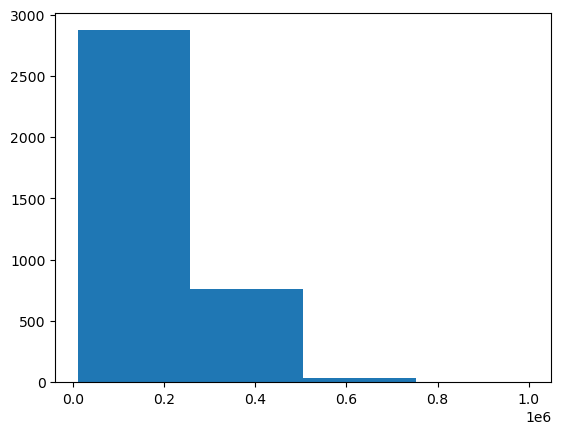

In [25]:




header = credit.dtypes.index
print(header)


#plt.show()
plt.hist(credit['LIMIT_BAL'], bins=4)
plt




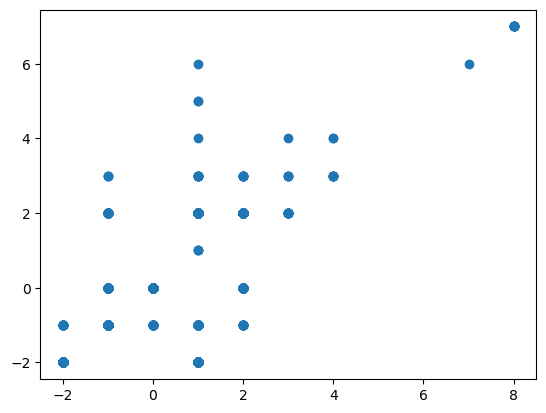

In [26]:


x = credit['PAY_0']
y = credit['PAY_2']

plt.scatter(x,y)
plt.show()